# TIKSLAI

In [ ]:
# 1968-2018 Duomenų bazė

# Darbo tikslai:

# SQL: --

# Python:

# Duomenų bazėje yra daug NaN reikšmių, tai tiesiog kaikurias reikšmes pakeisti kitu vardu.
# Pakeisti datos formatą
# Sukurti funkcijas kurios padėtu greičiau naviguoti.

# 1. Sužinoti kuris žaidėjas laimėjo daugiausiai turnyru, bei kuris žaidėjas daugiausiai pralošė turnyrų.
# 2. Sužinoti, ar visgi laimetojai muša kamuoliuka geriau, nei pralaimėtojai(ACE).
# 3. Sužinoti kokie yra laimėtoju, bei pralaimėtoju metai, kokie yra ju maksimalus metai.
# 4. Nustatyti Kiek minučių vidutiniškai yra žaidžiama ant tam tikros dangos.
# 5. Sužinoti kuri šalis laimi daugiausiai matchų. 

# HIPOTEZĖS:

# Ar Amerika geriausia?
# Ar tarp laimėtojų ir pralaimėtojų padavimo rankos yra kažkoks skirtumas?

# TABLEAU:

# Sužinoti koks žaidėjas koki turnyra laimėjo, ir koks to turnyro laimėjimo vidurkis pagal laimėtoju metus (TABLEAU)
# Išsiaiškinti Kokiu turnyru buvo sužaista daugiausiai, pagal turnyro lygi (TABLEAU)



![1](https://www.peternhof.com/media/system/animation01/desktop/hotel-peternhof-themenbilder-tennisschlaeger.jpg)

In [398]:
import pandas as pd
import numpy as np
import seaborn as sns
import mysql.connector
import matplotlib.pyplot as plt
tenisas = pd.read_csv("D:\Projektas\ATP.csv",engine="python",encoding="latin1")
# Pirmos 3 eilutes

In [ ]:
# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

In [ ]:
# Funkcijos

In [399]:
# Greitesniam valdymui:

def a():
    return(tenisas.head(3))

def t():
    return(tenisas.tail(3))

def i():
    return(tenisas.info())

def il():
    return(tenisas.iloc())

def nul():
    return(tenisas.isnull().sum())

def de():
    return(tenisas.describe())

# def de():
#     return(tenisas['match_num'].describe())


In [415]:
def abc(n):
    if n == tenisas:
        print(tenisas)

In [416]:
abc

<function __main__.abc(n)>

In [348]:
# tenisas.shape

In [349]:
# tenisas.columns
# Stulpeliu rodymas

In [354]:
tenisas['surface']

0         Grass
1         Grass
2         Grass
3         Grass
4         Grass
          ...  
168952     Clay
168953     Hard
168954     Hard
168955     Hard
168956     Hard
Name: surface, Length: 168957, dtype: object

In [417]:
tenisas[
    (tenisas['surface'].isin(['Hard', 'Grass', 'Carpet'])) & 
    (tenisas['winner_rank'] >= 100)] 

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,ace_
10151,10152,1973-2016,London,Carpet,32.0,A,19731117.0,2.0,100304.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10164,10165,1973-2016,London,Carpet,32.0,A,19731117.0,15.0,100251.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10469,10470,1973-498,Osaka,Hard,32.0,A,19731007.0,10.0,100346.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10472,10473,1973-498,Osaka,Hard,32.0,A,19731007.0,13.0,100156.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10473,10474,1973-498,Osaka,Hard,32.0,A,19731007.0,14.0,100149.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168949,168950,2018-M-DC-2018-WG-PO-JPN-BIH-01,Davis Cup WG PO: JPN vs BIH,Hard,4.0,D,20180914.0,4.0,133297.0,NaN,...,4.0,1.0,46.0,26.0,14.0,9.0,8.0,1.0,5.0,0.500000
168953,168954,2018-M-DC-2018-WG-PO-SUI-SWE-01,Davis Cup WG PO: SUI vs SWE,Hard,4.0,D,20180914.0,1.0,105436.0,NaN,...,19.0,7.0,169.0,103.0,72.0,33.0,25.0,10.0,15.0,0.736842
168954,168955,2018-M-DC-2018-WG-PO-SUI-SWE-01,Davis Cup WG PO: SUI vs SWE,Hard,4.0,D,20180914.0,2.0,105967.0,NaN,...,8.0,1.0,96.0,54.0,39.0,19.0,14.0,5.0,10.0,1.250000
168955,168956,2018-M-DC-2018-WG-PO-SUI-SWE-01,Davis Cup WG PO: SUI vs SWE,Hard,4.0,D,20180914.0,4.0,105967.0,NaN,...,4.0,3.0,143.0,102.0,54.0,19.0,17.0,12.0,20.0,4.250000


In [276]:
tenisas['tourney_date']

0         19680119.0
1         19680119.0
2         19680119.0
3         19680119.0
4         19680119.0
             ...    
168952    20180914.0
168953    20180914.0
168954    20180914.0
168955    20180914.0
168956    20180914.0
Name: tourney_date, Length: 168957, dtype: float64

In [139]:
tenisas['tourney_date'] = tenisas['tourney_date'].astype('datetime64[ns]') 
# Keičių datos formatą

In [140]:
tenisas['tourney_date'] = pd.to_datetime(tenisas['tourney_date'].dt.date)
# tenisas['tourney_date'] = pd.to_datetime(tenisas['Laikas'])

In [141]:
tenisas['tourney_date']

0        1970-01-01
1        1970-01-01
2        1970-01-01
3        1970-01-01
4        1970-01-01
            ...    
168952   1970-01-01
168953   1970-01-01
168954   1970-01-01
168955   1970-01-01
168956   1970-01-01
Name: tourney_date, Length: 168957, dtype: datetime64[ns]

In [126]:
type(tenisas)

pandas.core.frame.DataFrame

In [ ]:
# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

# SQL dalis

In [ ]:
import mysql.connector

In [331]:
# MySQL neužkrove duomenu...

In [90]:
# mydb = mysql.connector.connect(
#     host='localhost',
#     port='3317',
#     user='root',
#     password='***'
    
# )

# cursor = mydb.cursor()
# cursor.execute('SHOW DATABASES')
# for i in cursor:
#     print(i)

# Duomenu baze: ('tenisas',)

('information_schema',)
('mysql',)
('performance_schema',)
('sakila',)
('studentai',)
('sys',)
('tenisas',)
('world',)


In [561]:
# cursor.execute('USE tenisas')
# sql_tenisas = pd.read_sql('SELECT * FROM ATP', con=mydb, index_col='matchid')
# sql_tenisas

In [ ]:
# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

In [47]:
a()
# Parodo pirmas 3 eilutes.

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,prediction
0,1,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,1.0,110023.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,86.5
1,2,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,2.0,109803.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,86.5
2,3,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,3.0,100257.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,86.5


In [22]:
il()[3:15]
# Filtravimas Nuo 3 iki 15.

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
3,4,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,4.0,100105.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,5.0,109966.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,6,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,6.0,107759.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,7,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,7.0,100101.0,12.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,8,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,8.0,100025.0,3.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,9,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,9.0,108519.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,10,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,10.0,109799.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10,11,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,11.0,100146.0,16.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
11,12,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,12.0,100180.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12,13,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,13.0,100013.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
t()
# Parodo 3 apatines eilutes

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
168954,168955,2018-M-DC-2018-WG-PO-SUI-SWE-01,Davis Cup WG PO: SUI vs SWE,Hard,4.0,D,20180914.0,2.0,105967.0,NaN,...,7.0,8.0,1.0,96.0,54.0,39.0,19.0,14.0,5.0,10.0
168955,168956,2018-M-DC-2018-WG-PO-SUI-SWE-01,Davis Cup WG PO: SUI vs SWE,Hard,4.0,D,20180914.0,4.0,105967.0,NaN,...,5.0,4.0,3.0,143.0,102.0,54.0,19.0,17.0,12.0,20.0
168956,168957,2018-M-DC-2018-WG-PO-SUI-SWE-01,Davis Cup WG PO: SUI vs SWE,Hard,4.0,D,20180914.0,5.0,111197.0,NaN,...,2.0,4.0,0.0,125.0,72.0,55.0,30.0,20.0,5.0,7.0


In [584]:
nul()
# Suskaiciuoju NaN reiksmes

matchid                    0
tourney_id                 0
tourney_name               0
surface                 2567
draw_size                  0
tourney_level              0
tourney_date               0
match_num                  0
winner_id                  0
winner_seed           103918
winner_entry          154367
winner_name                0
winner_hand               35
winner_ht              19278
winner_ioc                 0
winner_age              3445
winner_rank            24660
winner_rank_points     24660
loser_id                   0
loser_seed            136239
loser_entry           143838
loser_name                 0
loser_hand                65
loser_ht               30972
loser_ioc                  0
loser_age               6569
loser_rank             27844
loser_rank_points      27844
score                    175
best_of                    0
round                      0
minutes                89136
w_ace                  86603
w_df                   86603
w_svpt        

In [ ]:
# tenisas.dropna(how='all') Jei visi NaN
# tenisas.dropna(thresh=2) Jei bent dveju values nėra.
# tenisas.drop(columns=['score'], axis=1, inplace = True) Visa stulpeli ištrina.

In [6]:
nul().max()
# Ganetinai daug NaN reikšmių.

154367

In [270]:
tenisas[tenisas.isna()]
# Redaguoju NaN reikmes

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168952,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
168953,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
168954,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
168955,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [143]:
tenisas["winner_hand"].fillna("unknown", inplace = True)
tenisas["l_ace"].fillna("unknown", inplace = True)

# stulpelių pakeitimas, is NaN i uknown

In [144]:
a()

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
0,1,1968-580,Australian Chps.,Grass,64.0,G,1970-01-01,1.0,110023.0,NaN,...,NaN,unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,1968-580,Australian Chps.,Grass,64.0,G,1970-01-01,2.0,109803.0,NaN,...,NaN,unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3,1968-580,Australian Chps.,Grass,64.0,G,1970-01-01,3.0,100257.0,NaN,...,NaN,unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [60]:
tenisas[['tourney_name', 'surface', 'tourney_level','tourney_date']].head(10)
# Filtravimas 10 pirmųjų: Turnyro id, turnyro pavadinimas, danga, turnyro lygis, Turnyro data.

,tourney_name,surface,tourney_level,tourney_date
0,Australian Chps.,Grass,G,19680119.0
1,Australian Chps.,Grass,G,19680119.0
2,Australian Chps.,Grass,G,19680119.0
3,Australian Chps.,Grass,G,19680119.0
4,Australian Chps.,Grass,G,19680119.0
5,Australian Chps.,Grass,G,19680119.0
6,Australian Chps.,Grass,G,19680119.0
7,Australian Chps.,Grass,G,19680119.0
8,Australian Chps.,Grass,G,19680119.0
9,Australian Chps.,Grass,G,19680119.0


In [52]:
tenisas[tenisas['tourney_name'] == 'Davis Cup WG PO: SRB vs IND']
# Parodo turnyro statistika

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
168950,168951,2018-M-DC-2018-WG-PO-SRB-IND-01,Davis Cup WG PO: SRB vs IND,Clay,4.0,D,20180914.0,1.0,111513.0,NaN,...,8.0,6.0,4.0,134.0,76.0,47.0,35.0,19.0,4.0,8.0
168951,168952,2018-M-DC-2018-WG-PO-SRB-IND-01,Davis Cup WG PO: SRB vs IND,Clay,4.0,D,20180914.0,2.0,105583.0,NaN,...,9.0,2.0,3.0,78.0,56.0,33.0,10.0,14.0,3.0,8.0
168952,168953,2018-M-DC-2018-WG-PO-SRB-IND-01,Davis Cup WG PO: SRB vs IND,Clay,4.0,D,20180914.0,4.0,106353.0,NaN,...,1.0,4.0,4.0,59.0,28.0,17.0,9.0,8.0,3.0,8.0


In [ ]:
tenisas[tenisas['tourney_name'] == 'Davis Cup WG PO: SRB vs IND']

In [ ]:
# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

# Grafikai

In [ ]:
# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

## 1

In [763]:
tenisas['winner_name'].value_counts().head(15)
# Daugiausiai laimejo matchu
# 1. Sužinoti kuris žaidėjas laimėjo daugiausiai turnyru, bei kuris žaidėjas daugiausiai pralošė turnyrų.

# Išsiaiškinau jog laimėjo daugiausiai matchu Jimmy Connors netgi 1229
# Daugiausiai pralaimėjo 444 Fabrice Santoro

Jimmy Connors      1229
Roger Federer      1179
Ivan Lendl         1065
Guillermo Vilas     937
Rafael Nadal        926
John Mcenroe        881
Andre Agassi        861
Novak Djokovic      834
Ilie Nastase        826
Stefan Edberg       796
Pete Sampras        763
David Ferrer        732
Boris Becker        711
Manuel Orantes      690
Brian Gottfried     681
Name: winner_name, dtype: int64

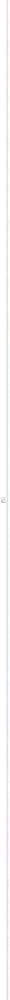

In [364]:
sns.displot(tenisas, x="winner_ioc", hue="winner_name")

In [300]:
tenisas['loser_name'].value_counts().head(10)
# Daugiausiai pralaimejo matchu

Fabrice Santoro      444
Feliciano Lopez      426
Mikhail Youzhny      423
Fernando Verdasco    384
John Alexander       382
David Ferrer         373
Andreas Seppi        368
Jonas Bjorkman       361
Tommy Robredo        360
Vincent Spadea       356
Name: loser_name, dtype: int64

In [59]:
tenisas[tenisas['winner_name'] == 'Jimmy Connors']
# Tikrinu žaidėjo statistika kuris yra daugiausiai laimėjas

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
3573,3574,1970-2067,Phoenix,Hard,32.0,A,19701018.0,14.0,100284.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4026,4027,1970-423,Los Angeles,Hard,64.0,A,19700919.0,24.0,100284.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4046,4047,1970-423,Los Angeles,Hard,64.0,A,19700919.0,44.0,100284.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4376,4377,1971-2058,New York,NaN,32.0,A,19710214.0,13.0,100284.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4551,4552,1971-2051,Tanglewood,Hard,64.0,A,19710724.0,21.0,100284.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85041,85042,1993-424,San Francisco,Hard,32.0,A,19930201.0,21.0,100284.0,NaN,...,3.0,15.0,10.0,102.0,47.0,34.0,29.0,16.0,3.0,7.0
85047,85048,1993-424,San Francisco,Hard,32.0,A,19930201.0,27.0,100284.0,NaN,...,9.0,6.0,1.0,82.0,55.0,36.0,17.0,14.0,2.0,4.0
91007,91008,1994-409,Atlanta,Clay,32.0,A,19940425.0,7.0,100284.0,NaN,...,13.0,0.0,4.0,89.0,61.0,31.0,11.0,11.0,12.0,18.0
93293,93294,1995-500,Halle,Grass,32.0,A,19950619.0,10.0,100284.0,NaN,...,8.0,14.0,7.0,67.0,37.0,30.0,11.0,11.0,3.0,6.0


In [145]:
tenisas[tenisas['loser_name'] == 'Fabrice Santoro']
# Tikrinu žaidėjo statistika kuris yra daugiausiai pralaimėjas

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
70451,70452,1989-352,Paris Indoor,Carpet,32.0,A,1970-01-01,2.0,101098.0,NaN,...,NaN,unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
71338,71339,1989-410,Monte Carlo,Clay,48.0,A,1970-01-01,6.0,100894.0,NaN,...,NaN,unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
71911,71912,1989-520,Roland Garros,Clay,128.0,G,1970-01-01,14.0,101609.0,NaN,...,NaN,unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
72381,72382,1989-327,Toulouse,Hard,32.0,A,1970-01-01,21.0,101377.0,NaN,...,NaN,unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
72744,72745,1989-321,Stuttgart Outdoor,Clay,48.0,A,1970-01-01,34.0,101649.0,7.0,...,NaN,unknown,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
141523,141524,2009-341,Metz,Hard,28.0,A,1970-01-01,6.0,103294.0,NaN,...,9.0,20.0,2.0,79.0,46.0,35.0,11.0,14.0,1.0,6.0
141649,141650,2009-580,Australian Open,Hard,128.0,G,1970-01-01,105.0,104053.0,7.0,...,3.0,4.0,2.0,79.0,45.0,31.0,16.0,13.0,7.0,11.0
141771,141772,2009-520,Roland Garros,Clay,128.0,G,1970-01-01,38.0,103294.0,NaN,...,14.0,11.0,4.0,113.0,59.0,36.0,22.0,17.0,7.0,15.0
142161,142162,2009-540,Wimbledon,Grass,128.0,G,1970-01-01,78.0,103507.0,NaN,...,6.0,7.0,3.0,140.0,86.0,58.0,24.0,20.0,13.0,19.0


In [ ]:
# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

## 2

Text(0.5, 1.0, 'Laimėtojai')

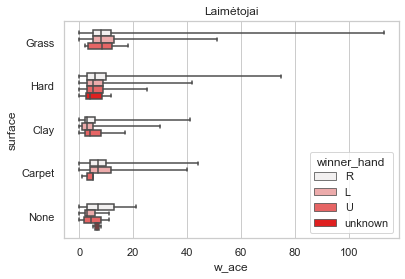

In [158]:
sns.boxplot(x='w_ace', y='surface', hue='winner_hand', color='red', data=tenisas , whis=[0, 100], width=.6 )
sns.set_theme(style="whitegrid")
plt.title('Laimėtojai')
# Su kokia ranka ir kokioje dangoje laimėtojai daugiausiai daro ace smugių.
# 2. Sužinoti, ar visgi laimetojai muša kamuoliuką geriau, nei pralaimėtojai(ACE)

# Apibendrinant galima teigti, jog geriausia daugiausia ACE smugiu daroma danga yra Grass, o blogiausia Carpet.
# Geriausias padavimas yra iš dešinės rankos,o kiek silpnesnis iš kaires.
# (Beabejo iki tikslaus vertinimo reiketu sužinoti žaidėju smugio stipruma)
# Vertinant laimėtoju ir pralaimėtu ACE smugius, galima pamatyti, kad laimėtoju smugiai yra ganėtinai tikslesni, nei pralaimėtoju, 
# tai reikškia, jog žaidėjas yra labiau techniškesnis, arba turi labai galinga smugį.

Text(0.5, 1.0, 'Regresija')

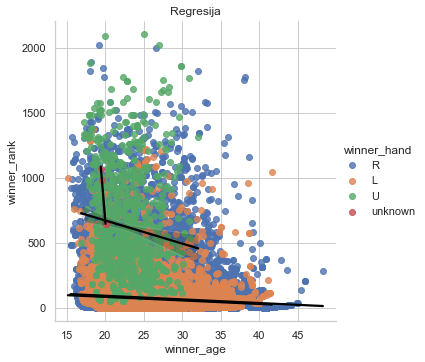

In [157]:
sns.lmplot(x="winner_age", y="winner_rank", hue="winner_hand", data=tenisas, line_kws={'color': 'black'})
plt.title('Regresija')
# Regresija

Text(0.5, 1.0, 'Laimėtojų Smugiai')

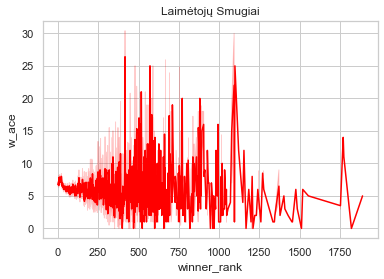

In [168]:
sns.lineplot(data=tenisas, x="winner_rank", color='red', y="w_ace")
plt.title('Laimėtojų Smugiai')
# Laimėtoju ACE smugiai

Text(0.5, 1.0, 'Pralaimėtojai')

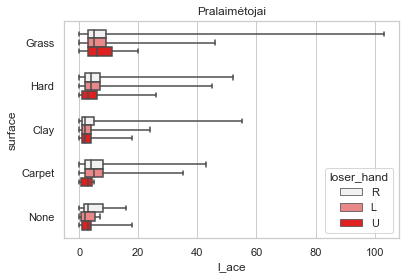

In [166]:
sns.boxplot(x='l_ace', y='surface', hue='loser_hand', color='red', data=tenisas, whis=[0, 100], width=.6 )
plt.title('Pralaimėtojai')
# Su kokia ranka ir kokioje dangoje pralaimėtojai padaro daugiausiai ace smugių.

Text(0.5, 1.0, 'Pralaimėtojų Smugiai')

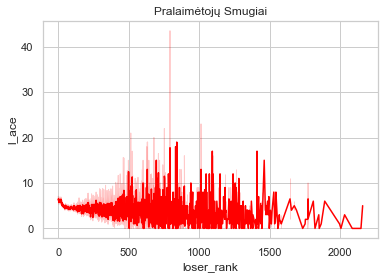

In [167]:
sns.lineplot(data=tenisas, x="loser_rank", color='red', y="l_ace")
plt.title('Pralaimėtojų Smugiai')
# Pralaimėtoju ACE smugiai

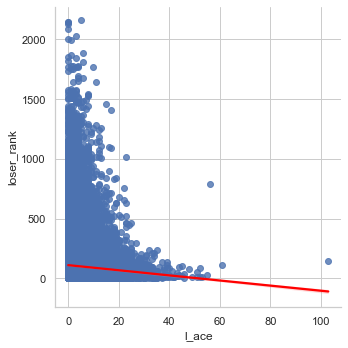

In [339]:
sns.lmplot(x="l_ace", y="loser_rank", data=tenisas, line_kws={'color': 'red'})
# Pralaimėtojų regresija

In [400]:
tenisas['ace_'] = tenisas['w_ace'] / tenisas['l_ace']
tenisas 
# kiek kartu atsilieka pralaimėtojai nuo laimėtojų

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,ace_
0,1,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,1.0,110023.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,2.0,109803.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,3.0,100257.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,4.0,100105.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,5.0,109966.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168952,168953,2018-M-DC-2018-WG-PO-SRB-IND-01,Davis Cup WG PO: SRB vs IND,Clay,4.0,D,20180914.0,4.0,106353.0,NaN,...,4.0,4.0,59.0,28.0,17.0,9.0,8.0,3.0,8.0,1.500000
168953,168954,2018-M-DC-2018-WG-PO-SUI-SWE-01,Davis Cup WG PO: SUI vs SWE,Hard,4.0,D,20180914.0,1.0,105436.0,NaN,...,19.0,7.0,169.0,103.0,72.0,33.0,25.0,10.0,15.0,0.736842
168954,168955,2018-M-DC-2018-WG-PO-SUI-SWE-01,Davis Cup WG PO: SUI vs SWE,Hard,4.0,D,20180914.0,2.0,105967.0,NaN,...,8.0,1.0,96.0,54.0,39.0,19.0,14.0,5.0,10.0,1.250000
168955,168956,2018-M-DC-2018-WG-PO-SUI-SWE-01,Davis Cup WG PO: SUI vs SWE,Hard,4.0,D,20180914.0,4.0,105967.0,NaN,...,4.0,3.0,143.0,102.0,54.0,19.0,17.0,12.0,20.0,4.250000


## 3

Text(0.5, 1.0, 'Pralaimėtojų metai')

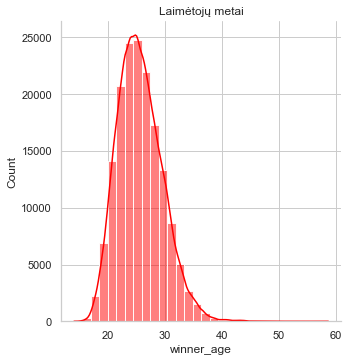

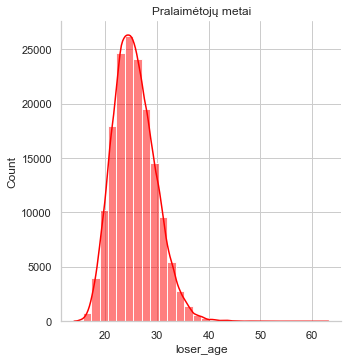

In [170]:
sns.displot(tenisas['winner_age'],bins=30, kde=30, color='red')
plt.title('Laimėtojų metai')
sns.displot(tenisas['loser_age'], bins=30, kde=30, color='red', linestyle='-')
plt.title('Pralaimėtojų metai')
# 3. Sužinoti kokie yra laimetoju, bei pralaimetoju metai, kokie yra ju maksimalus metai.

# 3. Išsiaiškinau jog daugiausiai yra 23 metų nugaletojų, o pralaimėtojų 79 kuriems 25 metai.
# Maksimalus laimėjuisio tenisininko amžius buvo 59 metai, o pralaimėtojo netgi 63
# nustebino labiausiai, jog net ir tokiu metu yra dalyvaujama turnyruose.

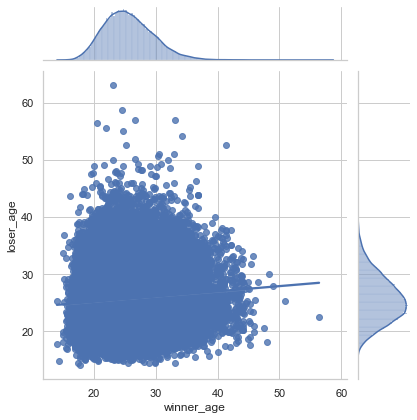

In [408]:
sns.jointplot(x='winner_age', y='loser_age', data=tenisas, kind='reg')
# plt.title('Laimėtojų ir pralaimėtojų regresija') Negražiai atrodo su title.
# Regresija Laimėtojai, ir pralaimėtojai

In [737]:
tenisas['winner_age'].value_counts().head(7)
# Daugiausiai žaidėju sukaičiuoti metai.(Laimėtojai)

22.825462    111
23.879535    104
26.622861     97
24.876112     86
22.850103     85
18.365503     84
22.995209     82
Name: winner_age, dtype: int64

In [972]:
tenisas['loser_age'].value_counts().head(7)
# Daugiau žaidėju suskaičiuoti metai.(Pralaimėtojai)

24.520192    79
23.071869    75
24.566735    72
23.515400    71
25.212868    69
22.015058    68
24.005476    67
Name: loser_age, dtype: int64

In [963]:
tenisas[['winner_age','loser_age']].max()

winner_age    58.718686
loser_age     63.211499
dtype: float64

In [ ]:
# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

## 4

Text(0.5, 1.0, 'Danga')

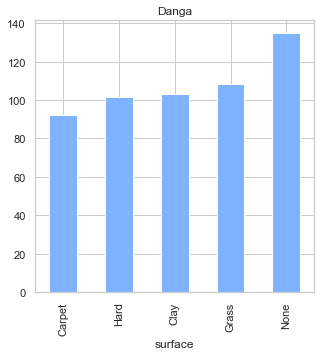

In [173]:
tenisas.groupby('surface')['minutes'].mean().sort_values(ascending=True).plot(kind='bar',  figsize=(5, 5), color='#80B3FF')
plt.title('Danga')
# 4. Kiek minučių vidutiniškai yra žaidžiama ant tam tikros dangos.
# None = nežinoma

# 4. Išsiaiskinau, kad daugiausiai žaidžiama apie 2h10min, mažiausiai apie 1h30min.
# None rezultatai rodo, kad kaikurie matchai trunka net apie 2h20min.
# Galima daryti prielaidą jog None rezultatuose yra labai didelių turnyrų kurie trunka iki 3 set'u pergales 

In [948]:
tenisas['surface'].value_counts().head(7)
# Kiek išviso sužaista matchu ant dangos.

Hard      66348
Clay      61298
Carpet    19826
Grass     18838
None         80
Name: surface, dtype: int64

In [76]:
tenisas[tenisas['surface'] == 'Carpet'].head(5)
# Carpet statistika

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
634,635,1968-352,Paris Indoor,Carpet,64.0,A,19680209.0,1.0,107312.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
635,636,1968-352,Paris Indoor,Carpet,64.0,A,19680209.0,2.0,109836.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
636,637,1968-352,Paris Indoor,Carpet,64.0,A,19680209.0,3.0,100089.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
637,638,1968-352,Paris Indoor,Carpet,64.0,A,19680209.0,4.0,199999.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
638,639,1968-352,Paris Indoor,Carpet,64.0,A,19680209.0,5.0,100199.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [69]:
tenisas[tenisas['surface'] == 'Hard'].head(5)
# Hard statistika

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
61,62,1968-423,Los Angeles,Hard,64.0,A,19680914.0,1.0,100029.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62,63,1968-423,Los Angeles,Hard,64.0,A,19680914.0,2.0,100144.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
63,64,1968-423,Los Angeles,Hard,64.0,A,19680914.0,3.0,100055.0,10.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
64,65,1968-423,Los Angeles,Hard,64.0,A,19680914.0,4.0,100094.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
65,66,1968-423,Los Angeles,Hard,64.0,A,19680914.0,5.0,100078.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [71]:
tenisas[tenisas['surface'] == 'Clay'].head(5)
# Clay statistika

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
124,125,1968-422,Cincinnati,Clay,16.0,M,19680707.0,1.0,109938.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
125,126,1968-422,Cincinnati,Clay,16.0,M,19680707.0,2.0,109977.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
126,127,1968-422,Cincinnati,Clay,16.0,M,19680707.0,3.0,100115.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
127,128,1968-422,Cincinnati,Clay,16.0,M,19680707.0,4.0,100127.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
128,129,1968-422,Cincinnati,Clay,16.0,M,19680707.0,5.0,100105.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [73]:
tenisas[tenisas['surface'] == 'Grass'].head(5)
# Grass statistika

,matchid,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_seed,...,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced
0,1,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,1.0,110023.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,2.0,109803.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,3.0,100257.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,4.0,100105.0,5.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,1968-580,Australian Chps.,Grass,64.0,G,19680119.0,5.0,109966.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

## 5

In [745]:
tenisas['winner_ioc'].value_counts().head(100)
# 5. Sužinoti kuri šalis laimi daugiausiai matchu, bei kuri šalis daugiausiai pralaimi 

# Išsiaiškinau jog pirmoje vietoje pagal laimėjimus yra USA
# Antroje ESP, idomu tai, jog USA yra pati pirma ir pagal pralaimėtojus. 
# Idomus faktas jog USA yra sužaidus išviso 67471 matchų.

USA    35514
ESP    14323
AUS    12399
FRA    10776
GER     8328
       ...  
VIE       27
URS       23
MKD       19
HAI       16
SOL       11
Name: winner_ioc, Length: 100, dtype: int64

Text(0.5, 1.0, 'Laimėtojų šalis')

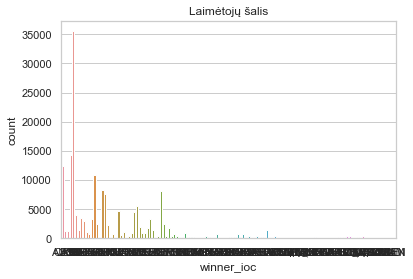

In [174]:
sns.countplot(x='winner_ioc', data=tenisas)
plt.title('Laimėtojų šalis')
# Daugiausiai laimėjo, nerodo šalių pavadinimu..

In [744]:
tenisas['loser_ioc'].value_counts().head(100)

USA    31957
AUS    12596
ESP    12453
FRA    11299
GER     9174
       ...  
AHO       51
SIN       47
MKD       47
QAT       43
SYR       34
Name: loser_ioc, Length: 100, dtype: int64

Text(0.5, 1.0, 'Pralaimėtojų šalis')

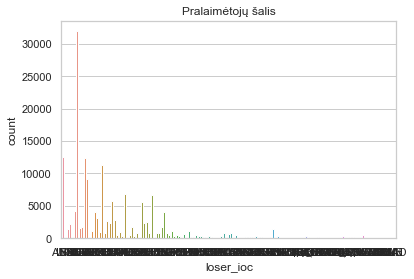

In [175]:
sns.countplot(x='loser_ioc', data=tenisas)
plt.title('Pralaimėtojų šalis')
# Daugiausiai pralaimėjo, nerodo šalių pavadinimu..

In [ ]:
# Daugiausiai ir mažiausiai suloštu turnyrų

In [729]:
tenisas['tourney_name'].value_counts().head(100)
# Daugiausiai žaista

Wimbledon          6477
Roland Garros      6413
US Open            6043
Australian Open    5129
Barcelona          2932
                   ... 
Geneva              480
South Orange        475
Louisville          456
London              437
Prague              434
Name: tourney_name, Length: 100, dtype: int64

In [204]:
# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

# Matricos

In [404]:
matrix = tenisas.corr()
round(matrix,1)

# Neįtraukia NaN reikšmių. 1 = vienas per kablelį

,matchid,draw_size,tourney_date,match_num,winner_id,winner_seed,winner_ht,winner_age,winner_rank,winner_rank_points,...,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,ace_
matchid,1.0,-0.0,1.0,0.3,0.4,0.2,0.2,0.0,0.0,0.5,...,0.1,-0.1,0.0,0.0,0.1,0.0,-0.0,-0.0,-0.0,0.0
draw_size,-0.0,1.0,0.0,0.3,-0.0,0.4,0.0,0.0,-0.2,0.1,...,0.2,0.2,0.5,0.4,0.4,0.3,0.4,0.2,0.3,0.0
tourney_date,1.0,0.0,1.0,0.3,0.4,0.2,0.2,0.0,0.0,0.5,...,0.1,-0.1,0.0,0.0,0.1,0.0,-0.0,-0.0,-0.0,0.0
match_num,0.3,0.3,0.3,1.0,0.2,0.1,0.1,0.1,-0.1,0.2,...,0.1,0.0,0.1,0.1,0.1,0.1,0.1,0.0,0.0,0.0
winner_id,0.4,-0.0,0.4,0.2,1.0,0.2,0.2,-0.1,0.1,0.2,...,0.0,-0.0,0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0,0.0
winner_seed,0.2,0.4,0.2,0.1,0.2,1.0,0.1,0.0,0.2,-0.2,...,0.1,0.1,0.2,0.2,0.2,0.2,0.2,0.1,0.1,0.0
winner_ht,0.2,0.0,0.2,0.1,0.2,0.1,1.0,-0.0,-0.1,0.1,...,0.0,-0.0,0.0,0.0,0.1,0.1,0.0,-0.1,-0.1,0.3
winner_age,0.0,0.0,0.0,0.1,-0.1,0.0,-0.0,1.0,-0.1,0.1,...,0.1,-0.0,0.0,0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0
winner_rank,0.0,-0.2,0.0,-0.1,0.1,0.2,-0.1,-0.1,1.0,-0.3,...,-0.0,0.1,0.0,0.0,0.0,0.0,0.0,-0.0,-0.0,-0.0
winner_rank_points,0.5,0.1,0.5,0.2,0.2,-0.2,0.1,0.1,-0.3,1.0,...,0.0,-0.1,0.0,0.0,0.0,-0.0,-0.0,0.0,0.0,0.0


<function matplotlib.pyplot.show(close=None, block=None)>

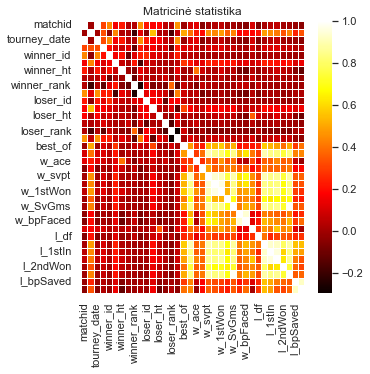

In [178]:
matrixa1 = plt.subplots(figsize=(5, 5))
sns.heatmap(matrix, linewidths=.5, cmap='hot')
plt.title( "Matricinė statistika")
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

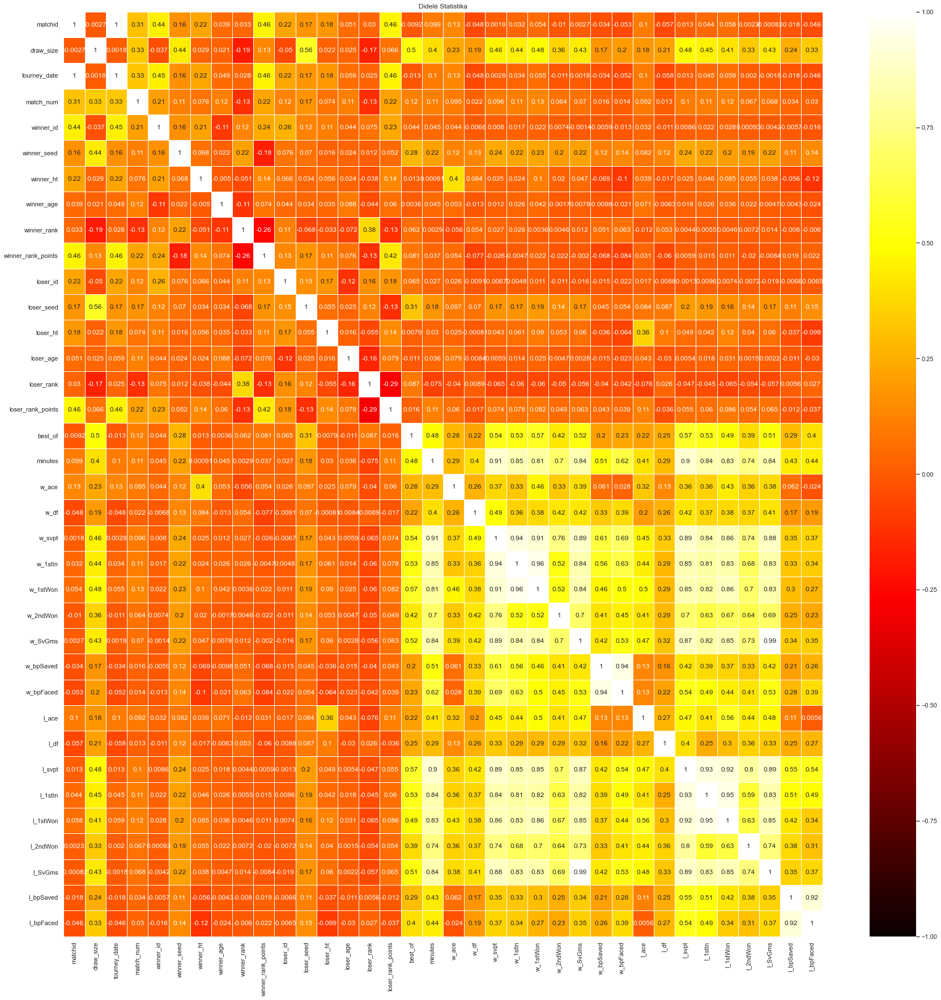

In [180]:
matrixa1 = plt.subplots(figsize=(30, 30))
sns.heatmap(matrix, linewidths=.5 ,vmin=-1, vmax=1, annot=True, cmap='hot')
plt.title( "Didelė Statistika")
plt.show

# Paprastai tamsesni diagramos atspalviai reiškia didesnes vertes nei šviesesni.

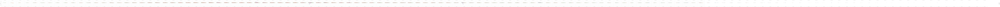

In [330]:
sns.lmplot(x="winner_age", y="winner_rank", hue="surface", col="w_1stWon", data=tenisas);
# Regresija

In [ ]:
# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

# TABLEAU

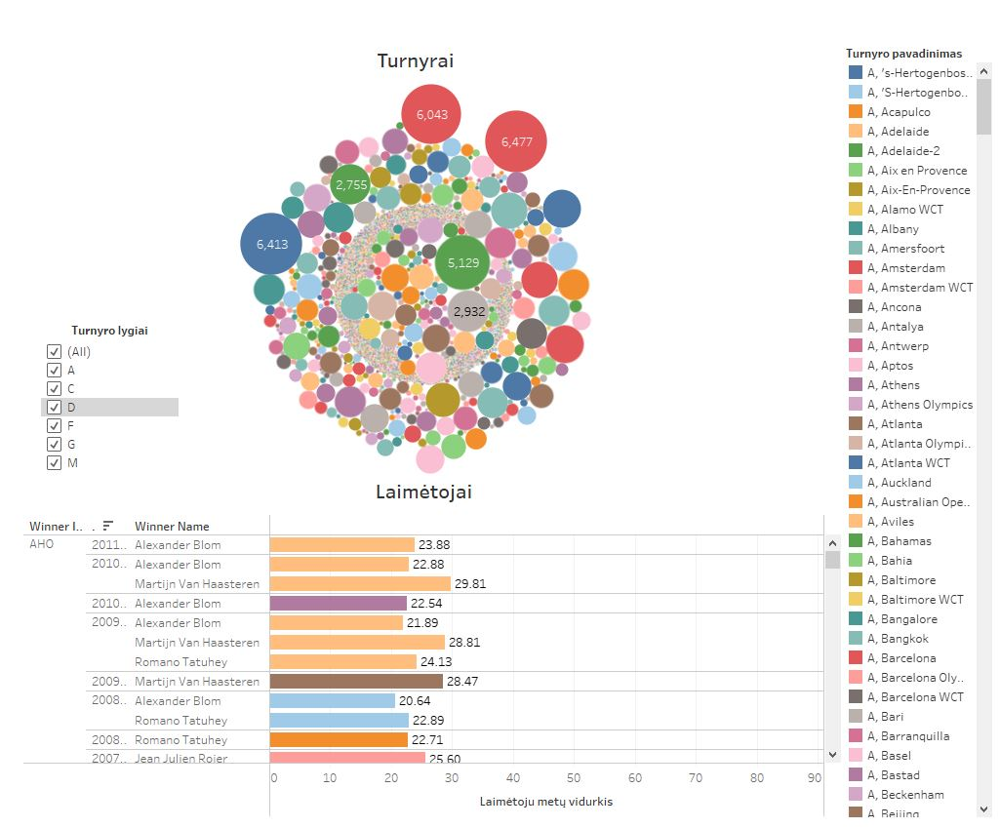

In [209]:
from IPython.display import Image
Image("D:\Projektas\Turnyrai.jpg", width = 800, height = 400)
# koki turnyra laimėjo, ir koks to turnyro vidurkis pagal laimėtojų metus (TABLEAU)
# Pasirinktas apvalus grafikas dėl teniso temos.

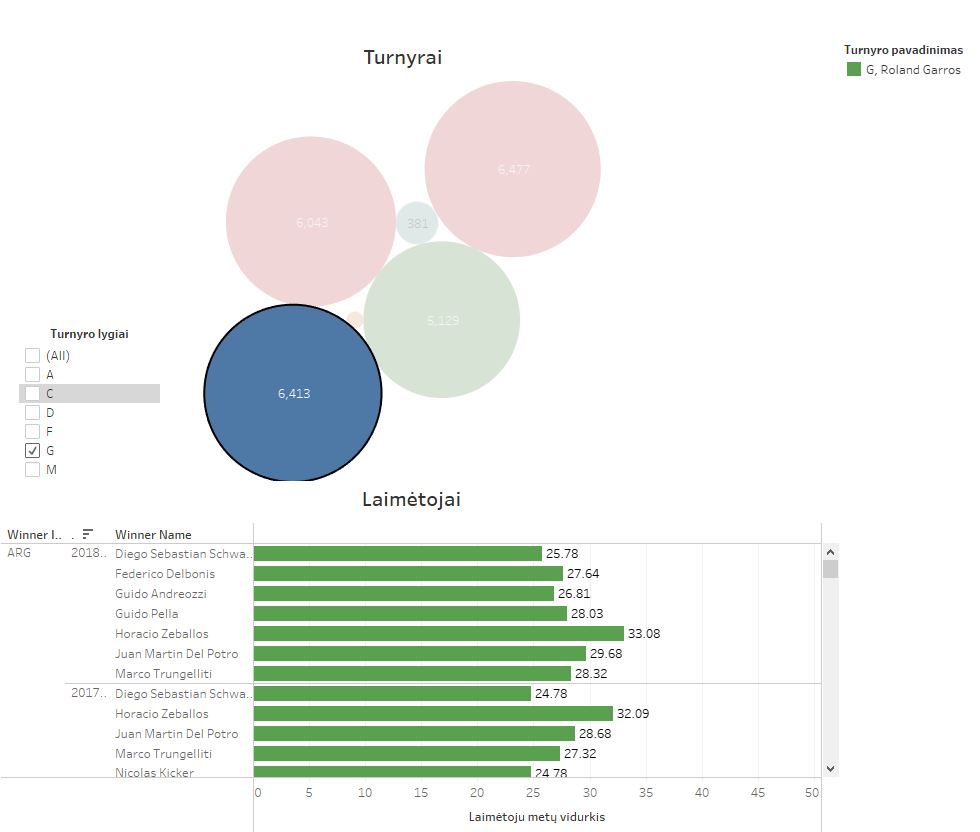

In [211]:
Image("D:\Projektas\TurnyraiG.jpg", width = 800, height = 400)
# Kokiu turnyru buvo sužaista daugiausiai, pagal turnyro lygi (TABLEAU)
# PVZ Turnyro lygis G : Pavadinimas. Roland Garros sužaista 6413 machu. Laimėjo Diego Sebastian met.vid 25.78

In [ ]:
# # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # # #

# Machine learning

# Spejimas?

In [235]:
dataset = np.array(
[['Jimmy Connors', 100, 1000],
['Roger Federer', 200, 2000],
['Ivan Lendl', 300, 3000],
['Guillermo Vilas', 400, 4000],
['Rafael Nadal', 500, 5000],
['Andre Agassi', 600, 6000],
['Novak Djokovice', 700, 7000],
['Ilie Nastase', 800, 8000],
['Stefan Edberg', 900, 9000],
['Pete Sampras', 1000, 10000],
['David Ferrer', 2000, 20000],
['Boris Becker', 3000, 30000],
['Manuel Orantes', 4000, 40000],
['Brian Gottfried', 5000, 50000]])
# Sukuria nauja data seta

In [236]:
X = dataset[:,1:2].astype(int) 
X
# Pirma eilutę paverčiam į int

array([[ 100],
       [ 200],
       [ 300],
       [ 400],
       [ 500],
       [ 600],
       [ 700],
       [ 800],
       [ 900],
       [1000],
       [2000],
       [3000],
       [4000],
       [5000]])

In [237]:
y = dataset[:,2].astype(int) 
y
# Antra eilutę paverčiam į int

array([ 1000,  2000,  3000,  4000,  5000,  6000,  7000,  8000,  9000,
       10000, 20000, 30000, 40000, 50000])

In [238]:
from sklearn.tree import DecisionTreeRegressor

regresija = DecisionTreeRegressor(random_state = 0)
# Sukuriamas regresijos objektas


In [239]:
regresija.fit(X, y)

DecisionTreeRegressor(random_state=0)

In [240]:
DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0,
                      random_state=0, splitter='best')

DecisionTreeRegressor(criterion='mse', random_state=0)

In [410]:
y_pred = regresija.predict([[22]])
print("Predikcija: % d\n"% y_pred)
# Iveskit spėjimą

Predikcija:  1000



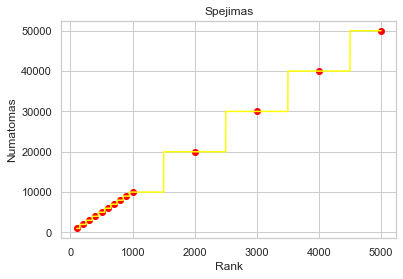

In [411]:
X_test = np.arange(min(X), max(X), 0.01)
# Iilgis  nuo min iki max. Su skirtumu pvz 0,02,0,03
 
X_test = X_test.reshape((len(X_test), 1)) 
plt.scatter(X, y, color = 'red')
plt.plot(X_grid, regresija.predict(X_test), color = 'yellow') 
plt.title('Spejimas') 
plt.xlabel('Rank')
plt.ylabel('Numatomas')
plt.show()

In [ ]:
# Spejimo rezultatai: 

# BAR CHART RACE

In [687]:
pip install bar_chart_race


     -------------------------------------- 156.8/156.8 KB 3.1 MB/s eta 0:00:00


In [146]:
import bar_chart_race as bcr
# Idėja buvo sukurti chart race, kad atvaizduoti kaip keitesi žaidėjo rank lyginant su metais

In [699]:
df = pd.read_csv("D:\\Projektas\ATP.csv",engine="python",encoding="latin1")


In [264]:
bcr.bar_chart_race(df=df, n_bars=5,filter_column_colors=True, title='Pirmas')
 
    

NameError: name 'df' is not defined

In [262]:
bcr.bar_chart_race(df=df, filename='ATP')

NameError: name 'df' is not defined

# IŠVADOS

In [ ]:
# 1. Išsiaiškinau jog laimėjo daugiausiai matchu Jimmy Connors netgi 1229
# Daugiausiai pralaimėjo 444 Fabrice Santoro

# 2. Apibendrinant galima teigti, jog geriausia daugiausia ACE smugiu daroma danga yra Grass, o blogiausia Carpet.
# Geriausias padavimas yra iš dešinės rankos,o kiek silpnesnis iš kaires.
# (Beabejo iki tikslaus vertinimo reiketu sužinoti žaidėju smugio stipruma)
# Vertinant laimėtoju ir pralaimėtu ACE smugius, galima pamatyti, kad laimėtoju smugiai yra ganėtinai tikslesni, nei pralaimėtoju, 
# tai reikškia, jog žaidėjas yra labiau techniškesnis, arba turi labai galinga smugį.

# 3. Išsiaiškinau jog daugiausiai yra 23 metų nugaletojų, o pralaimėtojų 79 kuriems 25 metai.
# Maksimalus laimėjuisio tenisininko amžius buvo 59 metai, o pralaimėtojo netgi 63
# nustebino labiausiai, jog net ir tokiu metu yra dalyvaujama turnyruose.

# 4. Išsiaiskinau, kad daugiausiai žaidžiama apie 2h10min, mažiausiai apie 1h30min.
# None rezultatai rodo, kad kaikurie matchai trunka net apie 2h20min.
# Galima daryti prielaidą jog None rezultatuose yra labai didelių turnyrų kurie trunka iki 3 set'u pergales 

# 5. Išsiaiškinau jog pirmoje vietoje pagal laimėjimus yra USA
# Antroje ESP, idomu tai, jog USA yra pati pirma ir pagal pralaimėtojus. 
# Idomus faktas jog USA yra sužaidus išviso 67471 matchų.

# HIPOTEZĖS

# 1. Iš laimėjimų galima teigti, kad taip
# 2. Taip, dešinerankiai kamuoliuką atmušą geriau. Galima teigti,
# jog gali susidaryti bendras vaizdas, jog tai itakojamą nuo priešininko žaidimo lygio.

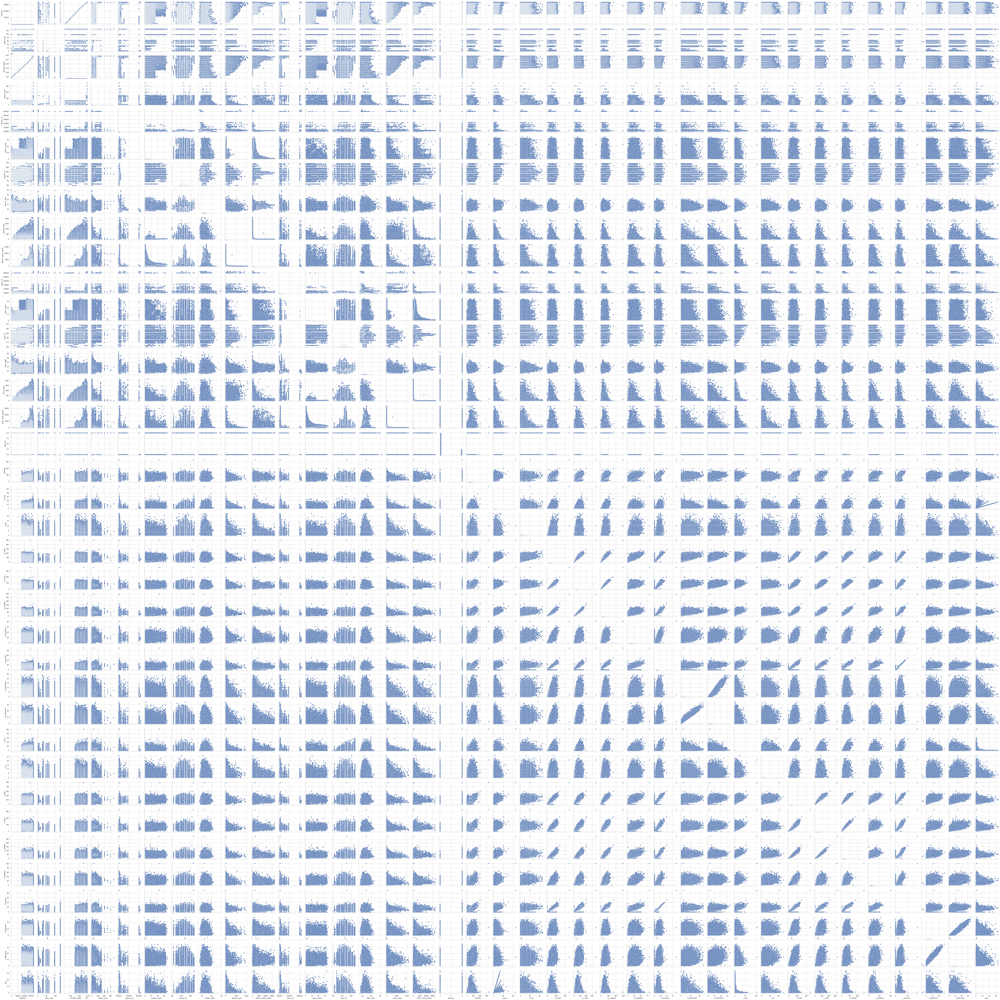

In [405]:
sns.pairplot(tenisas)
# Visų duomenų

![1](https://sportyreview.com/wp-content/uploads/2019/08/grass-courts-for-tennis-1024x683.jpg)

![1](https://www.pavitextennis.com/wp-content/uploads/2018/03/1-1.jpg)

![1](https://miro.medium.com/max/1400/1*6tNLqEVmBuMHrHhBHwqPEA.jpeg)

![](https://www.eye.co.jp/projects/examples/img/sports/sptn39/1_l.jpg)

![1](https://www.rookieroad.com/img/tennis/types-of-tennis-courts.png)

In [701]:
import os

In [706]:
os.getcwd()

'C:\\Users\\777z'

In [580]:
tinis = pd.DataFrame(tenisas)
tinis.to_csv(r'D:\\failai\tenis.csv', index = False, header=True)